# How to interpolate Antenna Patterns

In [34]:
include("../modules/antenna.jl")

# read in vpol grid
vgrid = Antenna.AntGrid("../inputs/darts_ant_03192021.nc");

# create grid to interpolate to
elf = -2.5:.01:2.5; 
azf = -15:.01:15;
fpt(x,y) = [-sind(x), cosd(x)sind(y), cosd(x)cosd(y)] #this is the Az over El grid definition
lvec = hcat([fpt(x,y) for x in azf, y in elf]...); # meshgrid

#interpolate the pattern
cp,xp = Antenna.interpolate_pattern(vgrid, lvec);

#reshape to plot
cp = reshape(cp, length(azf), length(elf));
xp = reshape(xp, length(azf), length(elf));

println(size(cp));
println(size(xp));


(3001, 501)
(3001, 501)


## plot the interpolated Antenna Patterns

In [35]:
using Plots

# plot Magnitude
p1 = contour(elf, azf, 20*log10.(abs.(cp)), 
    label = "", legend = :bottomleft, xlabel = "Elevation (deg)", ylabel = "Azimuth (deg)",
    title = "V-copol Grid Magnitude", clim=(-80,40), fill=true)
p2 = contour(elf, azf, 20*log10.(abs.(xp)), 
    label = "", legend = :bottomleft, xlabel = "Elevation (deg)", ylabel = "Azimuth (deg)",
    title = "V-crosspol Grid Magnitude", clim=(-80,40), fill=true)

# plot Phase
p3 = contour(elf, azf, 180/π*(angle.(cp)),
    label = "", legend = :bottomleft, xlabel = "Elevation (deg)", ylabel = "Azimuth (deg)",
    title = "V-copol Grid Phase", fill=true)
p4 = contour(elf, azf, 180/π*(angle.(xp)),
    label = "", legend = :bottomleft, xlabel = "Elevation (deg)", ylabel = "Azimuth (deg)",
    title = "V-crosspol Grid Phase", fill=true)

plot(p1, p2, p3, p4, layout = (2,2))

## read in, plot and interpolate H-pol grid pattern at a different frequency

In [36]:
# read in hpol grid
hgrid = Antenna.AntGrid("../inputs/darts_ant_03192021.nc", "Hpol", [1.23, 1.25, 1.27]);

# create grid to interpolate to
elf = -2.5:.01:2.5; 
azf = -10:.01:10;
fpt(x,y) = [-sind(x), cosd(x)sind(y), cosd(x)cosd(y)] #this is the Az over El grid definition
lvec = hcat([fpt(x,y) for x in azf, y in elf]...); # meshgrid

#interpolate the pattern at 1.265GHz
cp,xp = Antenna.interpolate_pattern(hgrid, lvec, 1.265);

#reshape to plot
cp = reshape(cp, length(azf), length(elf));
xp = reshape(xp, length(azf), length(elf));


# plot Magnitude
p1 = contour(elf, azf, 20*log10.(abs.(cp)), 
    label = "", legend = :bottomleft, xlabel = "Elevation (deg)", ylabel = "Azimuth (deg)",
    title = "H-copol Grid Magnitude", clim=(-80,40), fill=true)
p2 = contour(elf, azf, 20*log10.(abs.(xp)), 
    label = "", legend = :bottomleft, xlabel = "Elevation (deg)", ylabel = "Azimuth (deg)",
    title = "H-crosspol Grid Magnitude", clim=(-80,40), fill=true)

# plot Phase
p3 = contour(elf, azf, 180/π*(angle.(cp)),
    label = "", legend = :bottomleft, xlabel = "Elevation (deg)", ylabel = "Azimuth (deg)",
    title = "H-copol Grid Phase", fill=true)
p4 = contour(elf, azf, 180/π*(angle.(xp)),
    label = "", legend = :bottomleft, xlabel = "Elevation (deg)", ylabel = "Azimuth (deg)",
    title = "H-crosspol Grid Phase", fill=true)

plot(p1, p2, p3, p4, layout = (2,2))


# Interpolate Cuts along principal axes

(1001,)
(4001,)


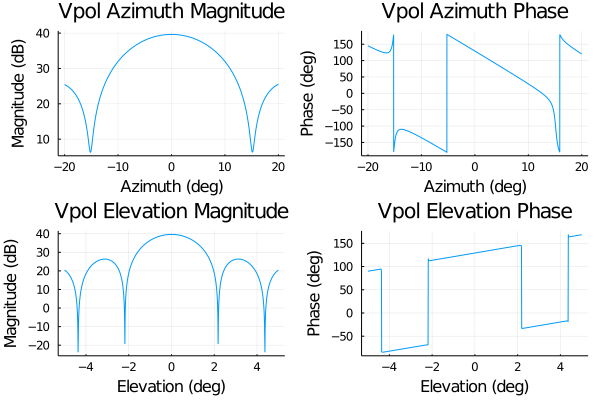

In [38]:
include("../modules/antenna.jl")

# read in vpol cuts
vcut = Antenna.AntCuts("../inputs/darts_ant_03192021.nc");

# create cuts to interpolate to
elf = -5:.01:5; 
azf = -20:.01:20;
fpt(x,y) = [-sind(x), cosd(x)sind(y), cosd(x)cosd(y)] #this is the Az over El grid definition
lvec_el = hcat([fpt(0,y) for y in elf]...); 
lvec_az = hcat([fpt(x,0) for x in azf]...); 

#interpolate the patterns - note interpolating crosspol from arbitary point does not make sense
el_cp = Antenna.interpolate_pattern(vcut, lvec_el);
az_cp = Antenna.interpolate_pattern(vcut, lvec_az);



# plot Az Magnitude
p1 = plot(azf, 20*log10.(abs.(az_cp)), 
    xlabel = "Azimuth (deg)", ylabel = "Magnitude (dB)", label="",
    legend = :bottomleft, title = "Vpol Azimuth Magnitude")

# plot Az Phase
p2 = plot(azf, 180/π*(angle.(az_cp)), 
    label = "", xlabel = "Azimuth (deg)", 
    ylabel = "Phase (deg)", title = "Vpol Azimuth Phase")


# plot El Magnitude
p3 = plot(elf, 20*log10.(abs.(el_cp)), 
    xlabel = "Elevation (deg)", ylabel = "Magnitude (dB)", label="",
    title = "Vpol Elevation Magnitude")

# plot Phase
p4 = plot(elf, 180/π*(angle.(el_cp)), 
    label = "", xlabel = "Elevation (deg)", ylabel = "Phase (deg)", 
    title = "Vpol Elevation Phase")


plot(p1, p2, p3, p4, layout = (2,2))


## Approximately Interpolate Cuts to a Grid

(301, 51)


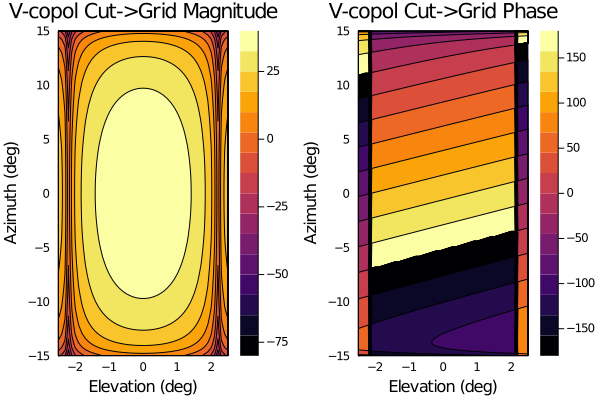

In [39]:

# create grid to interpolate to
elf = -2.5:.1:2.5; 
azf = -15:.1:15;
fpt(x,y) = [-sind(x), cosd(x)sind(y), cosd(x)cosd(y)] #this is the Az over El grid definition
lvec = hcat([fpt(x,y) for x in azf, y in elf]...); # meshgrid


#interpolate the patterns - note interpolating crosspol from arbitary point does not make sense
cp = Antenna.interpolate_pattern(vcut, lvec);

#reshape to plot
cp = reshape(cp, length(azf), length(elf));


# plot Magnitude
p1 = contour(elf, azf, 20*log10.(abs.(cp)), 
    label = "", legend = :bottomleft, xlabel = "Elevation (deg)", ylabel = "Azimuth (deg)",
    title = "V-copol Cut->Grid Magnitude", clim=(-80,40), fill=true)

# plot Phase
p2 = contour(elf, azf, 180/π*(angle.(cp)),
    label = "", legend = :bottomleft, xlabel = "Elevation (deg)", ylabel = "Azimuth (deg)",
    title = "V-copol Cut->Grid Phase", fill=true)

plot(p1, p2, layout = (1,2))
